In [1]:
# import pandas as pd
# import numpy as np
# import matplotlib.pyplot as plt

# Set up file path
# data_path = "/ssd4/cheng/DS/original_data/"

# Load the data
# data_x = pd.read_csv(f"{data_path}Wafer_train.csv").iloc[:, 1:]

# Generate grid for x and y coordinates
#xy_grid = pd.DataFrame([(y, x) for y in range(1, 29) for x in range(1, 29)], columns=["y", "x"])

# Load the wafer labels
# data_y = pd.read_csv(f"{data_path}Wafer_train_y.csv").iloc[:, 1]

'''
# Define example indices
examples = list(range(94,179,1))

# Plotting specified wafer examples in a grid
plt.figure(figsize=(10, 10))
for idx, i in enumerate(examples):
    wafer_data = data_x.iloc[i, :].values
    green = wafer_data == 0
    red = wafer_data == 1
    yellow = wafer_data == 2
    black = wafer_data == 3
    
    plt.subplot(3, 3, idx + 1)
    # plt.plot([1, 28], [1, 28], 'w')
    plt.scatter(xy_grid["x"][green], xy_grid["y"][green], color="green", marker="s")
    plt.scatter(xy_grid["x"][red], xy_grid["y"][red], color="red", marker="s")
    plt.scatter(xy_grid["x"][yellow], xy_grid["y"][yellow], color="yellow", marker="s")
    plt.title(data_y.unique()[idx])
plt.show()
'''

'''
# Display wafer data as images
plt.figure(figsize=(20, 20))
for idx, i in enumerate(examples):
    wafer_data = data_x.iloc[i, :].values
    wafer_matrix = wafer_data.reshape((28, 28))
    
    plt.subplot(10, 10, idx + 1)
    plt.imshow(wafer_matrix, cmap=plt.cm.colors.ListedColormap(["green", "red", "yellow", "white"]))
    # plt.title(data_y.unique()[idx])
plt.show()
'''

'''
def plot_ratio_bar(datax, datay, title):
    fig =plt.figure(figsize=(10, 10))
    df = pd.concat((datax, datay), axis=1)
    uqs = sorted(df["x"].unique())
    ratios = list(range(len(uqs)))
    for idx, uq in enumerate(uqs):
        a = df.loc[df["x"] == uq].drop(['x'], axis=1)
        c = 0
        for i in range(a.shape[0]):
            counts = a.iloc[i].value_counts().sort_index()
            all_values = [0, 1, 2]
            counts = counts.reindex(all_values)
            c = c + counts
        c = c / a.shape[0]
        
        # Make some labels.
        for i, v in enumerate(c.values):
            if not v > 0:
                c.values[i] = 0
        # print((c.values[1] + c.values[2]) / c.values[0])
        ratios[idx] = (c.values[1] + c.values[2]) / (c.values[0] )
        # print(c.values)
    
    plt.bar(uqs, ratios)
    plt.show()
plot_ratio_bar(data_x, data_y, None)
'''

'\ndef plot_ratio_bar(datax, datay, title):\n    fig =plt.figure(figsize=(10, 10))\n    df = pd.concat((datax, datay), axis=1)\n    uqs = sorted(df["x"].unique())\n    ratios = list(range(len(uqs)))\n    for idx, uq in enumerate(uqs):\n        a = df.loc[df["x"] == uq].drop([\'x\'], axis=1)\n        c = 0\n        for i in range(a.shape[0]):\n            counts = a.iloc[i].value_counts().sort_index()\n            all_values = [0, 1, 2]\n            counts = counts.reindex(all_values)\n            c = c + counts\n        c = c / a.shape[0]\n        \n        # Make some labels.\n        for i, v in enumerate(c.values):\n            if not v > 0:\n                c.values[i] = 0\n        # print((c.values[1] + c.values[2]) / c.values[0])\n        ratios[idx] = (c.values[1] + c.values[2]) / (c.values[0] )\n        # print(c.values)\n    \n    plt.bar(uqs, ratios)\n    plt.show()\nplot_ratio_bar(data_x, data_y, None)\n'

## Main

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Load the data
file_path = '/ssd4/cheng/DS/WM811K/WM811K_balanced.csv'  # Replace with your file path
data = pd.read_csv(file_path)

In [3]:
data_x =  data.iloc[:, 1:677] #785
data_y =  data.iloc[:, 677:678] #785:786

In [4]:
from sklearn.model_selection import train_test_split

# Split the data: 80%, 20%
x_train, x_val, y_train, y_val = train_test_split(data_x, data_y,test_size=0.2, random_state=777)

x_train.to_csv('./dataset/train_x.csv')
y_train.to_csv('./dataset/train_y.csv')
x_val.to_csv('./dataset/val_x.csv')
y_val.to_csv('./dataset/val_y.csv')

print(len(x_train), len(x_val))
print(len(y_train), len(y_val))

75527 18882
75527 18882


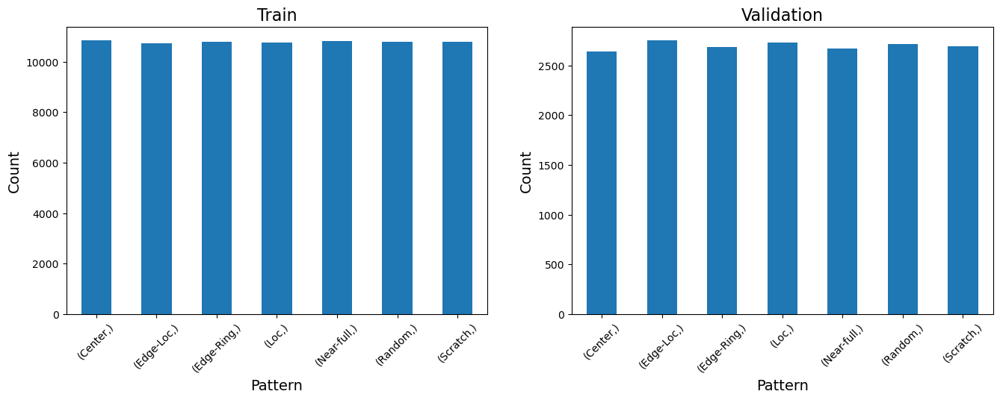

In [5]:

def plot_bar(data, idx, title):
    counts = data.value_counts().sort_index()
    plt.subplot(1, 2, idx)
    counts.plot(kind='bar', rot=45)
    plt.xlabel('Pattern', fontsize=14)
    plt.ylabel('Count', fontsize=14)
    plt.title(title, fontsize=16)

plt.figure(figsize=(16, 5))
titles = ["Train", "Validation"]
for i, data in enumerate([y_train, y_val]):
    plot_bar(data, i+1, titles[i])
plt.show()


In [6]:
import numpy as np
from skimage.feature.texture import graycomatrix


def calculate_haralick_features(image, distances=[1, 2, 3], angles=[0, np.pi/4, np.pi/2, 3*np.pi/4], levels=4):
    # 計算 GLCM
    glcm = graycomatrix(image, distances=distances, angles=angles, levels=levels, symmetric=True, normed=True)
    
    features = np.zeros((len(distances), len(angles), 14))
    for idx in range(len(distances)):
        for jdx in range(len(angles)):
            # GLCM矩陣
            glcm_prob = glcm[:, :, idx, jdx]

            # 索引
            i, j = np.indices(glcm_prob.shape)

            # **1. ASM (Angular Second Moment)**
            asm = np.sum(glcm_prob**2)

            # **2. Contrast**
            contrast = np.sum((i - j)**2 * glcm_prob)

            # **3. Correlation**
            mean_i = np.sum(i * glcm_prob)
            mean_j = np.sum(j * glcm_prob)
            std_i = np.sqrt(np.sum((i - mean_i)**2 * glcm_prob))
            std_j = np.sqrt(np.sum((j - mean_j)**2 * glcm_prob))
            correlation = np.sum((i - mean_i) * (j - mean_j) * glcm_prob / (std_i * std_j + np.finfo(float).eps))

            # **4. Entropy**
            entropy = -np.sum(glcm_prob * np.log(glcm_prob + np.finfo(float).eps))

            # **5. Homogeneity**
            homogeneity = np.sum(glcm_prob / (1 + np.abs(i - j)))

            # **6. Inverse Difference Moment (IDM)**
            idm = np.sum(glcm_prob / (1 + (i - j)**2))

            # **7. Maximum Probability**
            max_prob = np.max(glcm_prob)

            # **8. Variance**
            variance = np.sum((i - mean_i)**2 * glcm_prob)

            # **9. Sum Average**
            px_plus_y = np.zeros(2 * levels - 1)
            for k in range(2 * levels - 1):
                px_plus_y[k] = np.sum(glcm_prob[i + j == k])
            sum_average = np.sum(np.arange(2, 2 * levels + 1) * px_plus_y)

            # **10. Sum Entropy**
            sum_entropy = -np.sum(px_plus_y * np.log(px_plus_y + np.finfo(float).eps))

            # **11. Sum Variance**
            sum_variance = np.sum((np.arange(2, 2 * levels + 1) - sum_average)**2 * px_plus_y)

            # **12. Difference Average**
            px_minus_y = np.zeros(levels)
            for k in range(levels):
                px_minus_y[k] = np.sum(glcm_prob[np.abs(i - j) == k])
            diff_average = np.sum(np.arange(levels) * px_minus_y)

            # **13. Difference Entropy**
            diff_entropy = -np.sum(px_minus_y * np.log(px_minus_y + np.finfo(float).eps))

            # **14. Difference Variance**
            diff_variance = np.var(px_minus_y)

            # 收集特徵
            feats = {
                'ASM': asm,
                'Contrast': contrast,
                'Correlation': correlation,
                'Entropy': entropy,
                'Homogeneity': homogeneity,
                'IDM': idm,
                'Max Probability': max_prob,
                'Variance': variance,
                'Sum Average': sum_average,
                'Sum Entropy': sum_entropy,
                'Sum Variance': sum_variance,
                'Difference Average': diff_average,
                'Difference Entropy': diff_entropy,
                'Difference Variance': diff_variance,
            }
            features[idx, jdx] = np.array(list(feats.values())) 

    return glcm, features


wafer_img = data_x.iloc[0, :].values.reshape((26, 26))
glcm, features = calculate_haralick_features(wafer_img)

print("GLCM:")
print(glcm.shape)

print("\nFeatures:")
for idx in range(3):
    for jdx in range(4):
        print(features[idx, jdx])

GLCM:
(4, 4, 3, 4)

Features:
[0.25137396 0.42       0.48881927 1.63335102 0.81461538 0.81215385
 0.41538462 0.41081361 4.05384615 1.30427276 1.22325444 0.38307692
 0.72908725 0.06846923]
[0.25205888 0.4624     0.40922895 1.66336004 0.80293333 0.79952
 0.4256     0.39135296 4.1104     1.29776832 1.10301184 0.4112
 0.76090245 0.06443568]
[0.2501787  0.41846154 0.48571462 1.64483519 0.81333333 0.81107692
 0.41692308 0.40683787 4.05846154 1.31848301 1.20888994 0.38461538
 0.72634242 0.06828462]
[0.25245184 0.4368     0.441936   1.66385213 0.80933333 0.80656
 0.4288     0.39135296 4.1104     1.32009973 1.12861184 0.3952
 0.74158692 0.06671024]
[0.23597756 0.5        0.37284816 1.727287   0.78846154 0.78461538
 0.40705128 0.39862755 4.08974359 1.33449768 1.09451019 0.44230769
 0.78271474 0.06069712]
[0.25205888 0.4624     0.40922895 1.66336004 0.80293333 0.79952
 0.4256     0.39135296 4.1104     1.29776832 1.10301184 0.4112
 0.76090245 0.06443568]
[0.24095091 0.50961538 0.35512051 1.7331975

In [7]:
from skimage.transform import radon
from scipy.stats import skew, kurtosis
import numpy as np

def calculate_radon_features(image):
    """計算 Radon 轉換後的統計特徵"""
    # 根據圖像大小動態生成角度
    angles = np.linspace(0., 180., max(image.shape), endpoint=False)
    sinogram = radon(image, theta=angles, circle=True)
    
    # 計算統計特徵
    radon_mean = sinogram.mean(axis=0)
    radon_std = sinogram.std(axis=0)
    radon_max = sinogram.max(axis=0)
    radon_min = sinogram.min(axis=0)
    radon_skew = skew(sinogram, axis=0)
    radon_kurt = kurtosis(sinogram, axis=0)
    
    return radon_mean, radon_std, radon_max, radon_min, radon_skew, radon_kurt



In [8]:
len(data)

18882

In [9]:
##### 將每個distance, angle, haralick feature 都視為一個特徵 ==> 每一個wafer會有 n_dist x n_ang x 14 + wafer_0 + wafer_1 + wafer_2 + wafer_1_2 個特徵 #############
distances = [1, 2, 3]
angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]
df_x = pd.DataFrame(columns=list(range(len(distances) * len(angles) * 14 + 4 + 12 + 12 + 12 + 12 + 12 + 12 + 1 + 1 + 6 + 156 )))  # 更新特徵數量 # + 12 + 12 + 12 + 12 + 12 + 12 + 1 + 1 + 6

wafer_img = x_train.iloc[i, :].values.reshape((26, 26))
glcm, features = calculate_haralick_features(wafer_img, distances=distances, angles=angles)

'''
for i in range(x_train.shape[0]):
    data = []
    data.extend([(x_train.iloc[i, :]==0).sum(),
                (x_train.iloc[i, :]==1).sum(),
                (x_train.iloc[i, :]==2).sum(), 
                (x_train.iloc[i, :]==1).sum()+(x_train.iloc[i, :]==2).sum()])
    wafer_img = x_train.iloc[i, :].values.reshape((26, 26))
    glcm, features = calculate_haralick_features(wafer_img, distances=distances, angles=angles)
    for idx in range(len(distances)):
        for jdx in range(len(angles)):
            data.extend(features[idx, jdx])
'''

for i in range(x_train.shape[0]):
    # 初始化特徵數組
    data = np.zeros(len(distances) * len(angles)  * 14 + 4 + 80 +156)
    
    # 計算額外的 4 個特徵
    data[:4] = [
        (x_train.iloc[i, :] == 0).sum()/676,
        (x_train.iloc[i, :] == 1).sum()/676,
        (x_train.iloc[i, :] == 2).sum()/676,
        ((x_train.iloc[i, :] == 1).sum() + (x_train.iloc[i, :] == 2).sum())/676
    ]
    
    # 計算 Haralick 特徵
    wafer_img = x_train.iloc[i, :].values.reshape(26, 26)
    glcm, features = calculate_haralick_features(wafer_img, distances=distances, angles=angles)
    
    feature_index = 4
    haralick_means = []
    haralick_stds = []
    haralick_maxs = []
    haralick_mins = []
    haralick_skew = []
    haralick_kurt = []

    
    for idx in range(len(distances)):
        for jdx in range(len(angles)):
            # 添加 Haralick 特徵
            data[feature_index:feature_index + 14] = features[idx, jdx]
            feature_index += 14
            
            # 記錄 Haralick 特徵的均值、標準差、最大值、最小值, 偏度與峰度
            haralick_means.append(features[idx, jdx].mean())
            haralick_stds.append(features[idx, jdx].std())
            haralick_maxs.append(features[idx, jdx].max())
            haralick_mins.append(features[idx, jdx].min())
            haralick_skew.append(skew(features[idx, jdx]))
            haralick_kurt.append(kurtosis(features[idx, jdx]))
    
    # 新增 Haralick 特徵的均值、標準差、最大值與最小值
    data[feature_index:feature_index + 12] = haralick_means
    feature_index += 12
    data[feature_index:feature_index + 12] = haralick_stds
    feature_index += 12
    data[feature_index:feature_index + 12] = haralick_maxs
    feature_index += 12
    data[feature_index:feature_index + 12] = haralick_mins
    feature_index += 12
    data[feature_index:feature_index + 12] = haralick_skew
    feature_index += 12
    data[feature_index:feature_index + 12] = haralick_kurt
    feature_index += 12
    
    # 計算 GLCM 對角線與非對角線比值
    diagonal_sum = np.sum(np.diag(glcm[:, :, 0, 0]))
    off_diagonal_sum = np.sum(glcm[:, :, 0, 0]) - diagonal_sum
    data[feature_index] = diagonal_sum / (off_diagonal_sum + np.finfo(float).eps)
    feature_index += 1
    
    # 計算 GLCM 稀疏度
    non_zero_count = np.count_nonzero(glcm[:, :, 0, 0])
    total_count = glcm[:, :, 0, 0].size
    data[feature_index] = non_zero_count / total_count
    feature_index += 1
    
    # 計算灰階統計特徵
    data[feature_index] = wafer_img.mean()
    feature_index += 1
    data[feature_index] = wafer_img.std()
    feature_index += 1
    data[feature_index] = wafer_img.max()
    feature_index += 1
    data[feature_index] = wafer_img.min()
    feature_index += 1
    data[feature_index] = skew(wafer_img.flatten())
    feature_index += 1
    data[feature_index] = kurtosis(wafer_img.flatten())
    feature_index += 1

    # 計算 Radon 特徵
    
    radon_mean, radon_std, radon_max, radon_min, radon_skew, radon_kurt = calculate_radon_features(wafer_img)
    data[feature_index:feature_index + 26] = list(radon_mean)
    feature_index += 26
    data[feature_index:feature_index + 26] = list(radon_std)
    feature_index += 26
    data[feature_index:feature_index + 26] = list(radon_max)
    feature_index += 26
    data[feature_index:feature_index + 26] = list(radon_min)
    feature_index += 26
    data[feature_index:feature_index + 26] = list(radon_skew)
    feature_index += 26    
    data[feature_index:feature_index + 26] = list(radon_kurt)

    # 存入 DataFrame
    df_x.loc[i] = data
    


/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/skimage/transform/radon_transform.py:74: UserWarning: Radon transform: image must be zero outside the reconstruction circle
  warn(
/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/skimage/transform/radon_transform.py:74: UserWarning: Radon transform: image must be zero outside the reconstruction circle
  warn(
/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/skimage/transform/radon_transform.py:74: UserWarning: Radon transform: image must be zero outside the reconstruction circle
  warn(
/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/skimage/transform/radon_transform.py:74: UserWarning: Radon transform: image must be zero outside the reconstruction circle
  warn(
/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/skimage/transform/radon_transform.py:74: UserWarning: Radon transform: image must be zero outside the reconstruction circle
  warn(
/home

In [ ]:
'''
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.svm import SVC
from lightgbm import LGBMClassifier
from sklearn.naive_bayes import GaussianNB
import pandas as pd
import numpy as np

from sklearn.preprocessing import LabelEncoder

# 創建 LabelEncoder 實例
label_encoder = LabelEncoder()

# 將字符串標籤轉換為數字
y_train_encoded = label_encoder.fit_transform(y_train)

# 如果需要對測試集也進行編碼，請確保使用相同的 encoder
y_test_encoded = label_encoder.transform(y_val)

# 定義 K-fold cross-validation
n_splits = 5
skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=777)

# 定義結果存儲
results_grid_search = {}

# 定義模型和參數
models_and_params = {
    "KNN": {
        "model": KNeighborsClassifier(),
        "params": {
            "n_neighbors": [3, 5, 7, 9],
            "weights": ['uniform', 'distance'],
            "p": [1, 2]
        }
    },
    "Random Forest": {
        "model": RandomForestClassifier(random_state=777),
        "params": {
            "n_estimators": [100, 200, 300],
            "max_depth": [None, 10, 20, 30],
            "min_samples_split": [2, 5, 10],
            "criterion": ['gini', 'entropy']
        }
    },
    "XGBoost": {
        "model": XGBClassifier(use_label_encoder=False, eval_metric='mlogloss', random_state=777),
        "params": {
            "n_estimators": [100, 200, 300],
            "max_depth": [3, 5, 7],
            "learning_rate": [0.01, 0.1, 0.3],
            "subsample": [0.8, 1],
            "colsample_bytree": [0.8, 1]
        }
    },
    "SVM": {
        "model": SVC(probability=True, random_state=777),
        "params": {
            "C": [0.1, 1, 10],
            "kernel": ['linear', 'rbf'],
            "gamma": ['scale', 'auto']
        }
    },
    "LightGBM": {
        "model": LGBMClassifier(random_state=777),
        "params": {
            "n_estimators": [100, 200, 300],
            "learning_rate": [0.01, 0.1, 0.3],
            "num_leaves": [20, 31, 50],
            "max_depth": [-1, 10, 20]
        }
    }
}

# 對每個模型進行 Grid Search 和 Cross-Validation
for model_name, config in models_and_params.items():
    print(f"\nTuning {model_name}...")
    
    model = config["model"]
    params = config["params"]
    
    # 使用標準化僅在需要時進行（如 KNN 和 SVM）
    if model_name in ["KNN", "SVM"]:
        scaler = StandardScaler()
        df_x_scaled = scaler.fit_transform(df_x)
        x_train_data = df_x_scaled
    else:
        x_train_data = df_x
    
    # 設定 GridSearchCV
    grid_search = GridSearchCV(
        model,
        param_grid=params,
        cv=skf,
        scoring='accuracy',
        n_jobs=-1,
        verbose=1
    )
    
    # 執行 Grid Search
    grid_search.fit(x_train_data, y_train_encoded.squeeze())
    
    # 存儲最佳參數和結果
    results_grid_search[model_name] = {
        "best_params": grid_search.best_params_,
        "best_score": grid_search.best_score_
    }
    
    print(f"Best Parameters for {model_name}: {grid_search.best_params_}")
    print(f"Best CV Accuracy for {model_name}: {grid_search.best_score_:.4f}")

# 輸出所有模型的最佳參數和結果
print("\nFinal Results:")
for model, result in results_grid_search.items():
    print(f"{model} - Best Params: {result['best_params']}, Best CV Accuracy: {result['best_score']:.4f}")
'''

In [10]:
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from lightgbm import LGBMClassifier
from sklearn.metrics import classification_report, accuracy_score
from sklearn.model_selection import StratifiedKFold
import numpy as np
import joblib


# 設置 k-fold
n_splits = 5  # k 的值
skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

# 建立 LabelEncoder
label_encoder = LabelEncoder()

# 儲存 k-fold 結果
results_kfold = {'KNN': [], 'Random Forest': [], 'XGBoost': [], 'LightGBM': []} #SVM

# **k-fold cross-validation**
for fold, (train_idx, val_idx) in enumerate(skf.split(df_x, y_train)):
    print(f"\nFold {fold + 1}/{n_splits}")

    # 分割訓練集和驗證集
    X_train_fold, X_val_fold = df_x.iloc[train_idx], df_x.iloc[val_idx]
    y_train_fold, y_val_fold = y_train.iloc[train_idx], y_train.iloc[val_idx]
    
    y_train_fold = label_encoder.fit_transform(y_train_fold)
    y_val_fold = label_encoder.fit_transform(y_val_fold)

    # 標準化 (僅在需要時)
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train_fold)
    X_val_scaled = scaler.transform(X_val_fold)

    # **1. KNN**
    print("Training KNN...")
    knn = KNeighborsClassifier(n_neighbors=5, p=1, weights='distance')  
    knn.fit(X_train_scaled, y_train_fold)
    y_val_pred_knn = knn.predict(X_val_scaled)
    accuracy_knn = accuracy_score(y_val_fold, y_val_pred_knn)
    results_kfold['KNN'].append(accuracy_knn)
    print(f"KNN Validation Accuracy (Fold {fold + 1}): {accuracy_knn:.4f}")
    joblib.dump(knn, 'knn_model.joblib')

    # **2. Random Forest**
    print("Training Random Forest...")
    rf = RandomForestClassifier(
        n_estimators=300, criterion='entropy', max_features='sqrt', max_depth=None, min_samples_split=2, 
        random_state=np.random.randint(100)
    )
    rf.fit(X_train_fold, y_train_fold)
    y_val_pred_rf = rf.predict(X_val_fold)
    accuracy_rf = accuracy_score(y_val_fold, y_val_pred_rf)
    results_kfold['Random Forest'].append(accuracy_rf)
    print(f"Random Forest Validation Accuracy (Fold {fold + 1}): {accuracy_rf:.4f}")
    joblib.dump(rf, 'rf_model.joblib')

    # **3. XGBoost**
    print("Training XGBoost...")
    xgb = XGBClassifier(
        use_label_encoder=False, eval_metric='mlogloss', random_state=np.random.randint(100),
        n_estimators=200, objective='multi:softmax', max_depth=5, min_child_weight=2, learning_rate=0.3,
    )
    xgb.fit(X_train_fold, y_train_fold)
    y_val_pred_xgb = xgb.predict(X_val_fold)
    accuracy_xgb = accuracy_score(y_val_fold, y_val_pred_xgb)
    results_kfold['XGBoost'].append(accuracy_xgb)
    print(f"XGBoost Validation Accuracy (Fold {fold + 1}): {accuracy_xgb:.4f}")
    joblib.dump(xgb, 'xgb_model.joblib')

    ''''
    # **4. SVM**
    print("Training SVM...")
    svm = SVC(C=10, gamma='scale', kernel='linear', probability=True, random_state=np.random.randint(100))
    svm.fit(X_train_scaled, y_train_fold)
    y_val_pred_svm = svm.predict(X_val_scaled)
    accuracy_svm = accuracy_score(y_val_fold, y_val_pred_svm)
    results_kfold['SVM'].append(accuracy_svm)
    print(f"SVM Validation Accuracy (Fold {fold + 1}): {accuracy_svm:.4f}")
    joblib.dump(svm, 'svm_model.joblib')
    '''

    # **5. LightGBM**
    print("Training LightGBM...")
    lgbm = LGBMClassifier(n_estimators=300,num_leaves=50,max_depth=-1, learning_rate=0.1, random_state=np.random.randint(100))
    lgbm.fit(X_train_fold, y_train_fold)
    y_val_pred_lgbm = lgbm.predict(X_val_fold)
    accuracy_lgbm = accuracy_score(y_val_fold, y_val_pred_lgbm)
    results_kfold['LightGBM'].append(accuracy_lgbm)
    print(f"LightGBM Validation Accuracy (Fold {fold + 1}): {accuracy_lgbm:.4f}")
    joblib.dump(lgbm, 'LGBM_model.joblib')



Fold 1/5


/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/sklearn/preprocessing/_label.py:114: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/sklearn/preprocessing/_label.py:114: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Training KNN...
KNN Validation Accuracy (Fold 1): 0.9967
Training Random Forest...
Random Forest Validation Accuracy (Fold 1): 0.9973
Training XGBoost...


/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [17:31:12] WARNING: /croot/xgboost-split_1724073744422/work/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBoost Validation Accuracy (Fold 1): 0.9977
Training LightGBM...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.033692 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 94632
[LightGBM] [Info] Number of data points in the train set: 60421, number of used features: 405
[LightGBM] [Info] Start training from score -1.940776
[LightGBM] [Info] Start training from score -1.951087
[LightGBM] [Info] Start training from score -1.944818
[LightGBM] [Info] Start training from score -1.949110
[LightGBM] [Info] Start training from score -1.943084
[LightGBM] [Info] Start training from score -1.947136
[LightGBM] [Info] Start training from score -1.945397
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits w

/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/sklearn/preprocessing/_label.py:114: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/sklearn/preprocessing/_label.py:114: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Training KNN...
KNN Validation Accuracy (Fold 2): 0.9958
Training Random Forest...
Random Forest Validation Accuracy (Fold 2): 0.9972
Training XGBoost...


/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [17:34:26] WARNING: /croot/xgboost-split_1724073744422/work/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBoost Validation Accuracy (Fold 2): 0.9972
Training LightGBM...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.035610 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 94554
[LightGBM] [Info] Number of data points in the train set: 60421, number of used features: 405
[LightGBM] [Info] Start training from score -1.940776
[LightGBM] [Info] Start training from score -1.951087
[LightGBM] [Info] Start training from score -1.944818
[LightGBM] [Info] Start training from score -1.949110
[LightGBM] [Info] Start training from score -1.943084
[LightGBM] [Info] Start training from score -1.947136
[LightGBM] [Info] Start training from score -1.945397
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits w

/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/sklearn/preprocessing/_label.py:114: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/sklearn/preprocessing/_label.py:114: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Training KNN...
KNN Validation Accuracy (Fold 3): 0.9954
Training Random Forest...
Random Forest Validation Accuracy (Fold 3): 0.9966
Training XGBoost...


/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [17:37:45] WARNING: /croot/xgboost-split_1724073744422/work/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBoost Validation Accuracy (Fold 3): 0.9974
Training LightGBM...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.035382 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 94600
[LightGBM] [Info] Number of data points in the train set: 60422, number of used features: 405
[LightGBM] [Info] Start training from score -1.940793
[LightGBM] [Info] Start training from score -1.951104
[LightGBM] [Info] Start training from score -1.944719
[LightGBM] [Info] Start training from score -1.949126
[LightGBM] [Info] Start training from score -1.943101
[LightGBM] [Info] Start training from score -1.947152
[LightGBM] [Info] Start training from score -1.945414
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits w

/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/sklearn/preprocessing/_label.py:114: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/sklearn/preprocessing/_label.py:114: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Training KNN...
KNN Validation Accuracy (Fold 4): 0.9960
Training Random Forest...
Random Forest Validation Accuracy (Fold 4): 0.9973
Training XGBoost...


/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [17:41:01] WARNING: /croot/xgboost-split_1724073744422/work/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBoost Validation Accuracy (Fold 4): 0.9977
Training LightGBM...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.035095 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 94581
[LightGBM] [Info] Number of data points in the train set: 60422, number of used features: 405
[LightGBM] [Info] Start training from score -1.940793
[LightGBM] [Info] Start training from score -1.951104
[LightGBM] [Info] Start training from score -1.944719
[LightGBM] [Info] Start training from score -1.949126
[LightGBM] [Info] Start training from score -1.943101
[LightGBM] [Info] Start training from score -1.947152
[LightGBM] [Info] Start training from score -1.945414
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits w

/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/sklearn/preprocessing/_label.py:114: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/sklearn/preprocessing/_label.py:114: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Training KNN...
KNN Validation Accuracy (Fold 5): 0.9962
Training Random Forest...
Random Forest Validation Accuracy (Fold 5): 0.9970
Training XGBoost...


/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/xgboost/core.py:158: UserWarning: [17:44:14] WARNING: /croot/xgboost-split_1724073744422/work/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBoost Validation Accuracy (Fold 5): 0.9970
Training LightGBM...
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.034526 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 94634
[LightGBM] [Info] Number of data points in the train set: 60422, number of used features: 405
[LightGBM] [Info] Start training from score -1.940793
[LightGBM] [Info] Start training from score -1.950987
[LightGBM] [Info] Start training from score -1.944719
[LightGBM] [Info] Start training from score -1.949126
[LightGBM] [Info] Start training from score -1.943101
[LightGBM] [Info] Start training from score -1.947268
[LightGBM] [Info] Start training from score -1.945414
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits w

In [11]:
# 平均結果
print("\nAverage Model Accuracies (k-fold cross-validation):")
for model, accuracies in results_kfold.items():
    print(f"{model}: {np.mean(accuracies):.4f} ± {np.std(accuracies):.4f}")


Average Model Accuracies (k-fold cross-validation):
KNN: 0.9960 ± 0.0004
Random Forest: 0.9971 ± 0.0003
XGBoost: 0.9974 ± 0.0003
LightGBM: 0.9976 ± 0.0003


In [ ]:
'''
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

knn_pred_classes = label_encoder.inverse_transform(y_val_pred_knn)
rf_pred_classes = label_encoder.inverse_transform(y_val_pred_rf)
xgb_pred_classes = label_encoder.inverse_transform(y_val_pred_xgb)
# svm_pred_classes = label_encoder.inverse_transform(y_val_pred_svm)
LGBM_pred_classes = label_encoder.inverse_transform(y_val_pred_lgbm)
y_val_fold = label_encoder.inverse_transform(y_val_fold)

# 計算並顯示 Confusion Matrix
models = {
    "KNN": knn_pred_classes,
    "Random Forest": rf_pred_classes,
    "XGBoost": xgb_pred_classes, #"SVM": svm_pred_classes,
    "LightGBM": LGBM_pred_classes
}


for model_name, predictions in models.items():
    cm = confusion_matrix(y_val_fold, predictions, labels=label_encoder.classes_)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_encoder.classes_)
    
    # 設置圖標題並顯示
    disp.plot(cmap=plt.cm.Blues)
    plt.title(f"{model_name} Confusion Matrix")
    plt.show()
'''

In [12]:
####### Test data generation #######
data_path = './dataset/'
data_x_test = pd.read_csv(f"{data_path}val_x.csv").iloc[:, 1:]
data_y_test = pd.read_csv(f"{data_path}val_y.csv").iloc[:, 1]

distances = [1, 2, 3]
angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]
df_x_test = pd.DataFrame(columns=list(range(len(distances) * len(angles) * 14 + 4 + 80 +156)))  # 更新特徵數量 + 12 + 12 + 12 + 12 + 12 + 12 + 1 + 1 + 6

'''
for i in range(data_x_test.shape[0]):
    data = []
    data.extend([(data_x_test.iloc[i, :]==0).sum(),
                (data_x_test.iloc[i, :]==1).sum(),
                (data_x_test.iloc[i, :]==2).sum(), 
                (data_x_test.iloc[i, :]==1).sum()+(data_x_test.iloc[i, :]==2).sum()])
    wafer_img = data_x_test.iloc[i, :].values.reshape((26, 26))
    glcm, features = calculate_haralick_features(wafer_img, distances=distances, angles=angles)
    for idx in range(len(distances)):
        for jdx in range(len(angles)):
            data.extend(features[idx, jdx])

    # 存入 DataFrame
    df_x_test.loc[i] = data

'''
for i in range(data_x_test.shape[0]):
    # 初始化特徵數組
    data = np.zeros(len(distances) * len(angles)  * 14 + 4 + 80 +156)
    
    # 計算額外的 4 個特徵
    data[:4] = [
        (data_x_test.iloc[i, :] == 0).sum()/676,
        (data_x_test.iloc[i, :] == 1).sum()/676,
        (data_x_test.iloc[i, :] == 2).sum()/676,
        ((data_x_test.iloc[i, :] == 1).sum() + (data_x_test.iloc[i, :] == 2).sum())/676
    ]
    
    # 計算 Haralick 特徵
    wafer_img = data_x_test.iloc[i, :].values.reshape((26, 26))
    glcm, features = calculate_haralick_features(wafer_img, distances=distances, angles=angles)
    
    feature_index = 4
    haralick_means = []
    haralick_stds = []
    haralick_maxs = []
    haralick_mins = []
    haralick_skew = []
    haralick_kurt = []

    
    for idx in range(len(distances)):
        for jdx in range(len(angles)):
            # 添加 Haralick 特徵
            data[feature_index:feature_index + 14] = features[idx, jdx]
            feature_index += 14
            
            # 記錄 Haralick 特徵的均值、標準差、最大值、最小值, 偏度與峰度
            haralick_means.append(features[idx, jdx].mean())
            haralick_stds.append(features[idx, jdx].std())
            haralick_maxs.append(features[idx, jdx].max())
            haralick_mins.append(features[idx, jdx].min())
            haralick_skew.append(skew(features[idx, jdx]))
            haralick_kurt.append(kurtosis(features[idx, jdx]))
    
    # 新增 Haralick 特徵的均值、標準差、最大值與最小值
    data[feature_index:feature_index + 12] = haralick_means
    feature_index += 12
    data[feature_index:feature_index + 12] = haralick_stds
    feature_index += 12
    data[feature_index:feature_index + 12] = haralick_maxs
    feature_index += 12
    data[feature_index:feature_index + 12] = haralick_mins
    feature_index += 12
    data[feature_index:feature_index + 12] = haralick_skew
    feature_index += 12
    data[feature_index:feature_index + 12] = haralick_kurt
    feature_index += 12
    
    # 計算 GLCM 對角線與非對角線比值
    diagonal_sum = np.sum(np.diag(glcm[:, :, 0, 0]))
    off_diagonal_sum = np.sum(glcm[:, :, 0, 0]) - diagonal_sum
    data[feature_index] = diagonal_sum / (off_diagonal_sum + np.finfo(float).eps)
    feature_index += 1
    
    # 計算 GLCM 稀疏度
    non_zero_count = np.count_nonzero(glcm[:, :, 0, 0])
    total_count = glcm[:, :, 0, 0].size
    data[feature_index] = non_zero_count / total_count
    feature_index += 1
    
    # 計算灰階統計特徵
    data[feature_index] = wafer_img.mean()
    feature_index += 1
    data[feature_index] = wafer_img.std()
    feature_index += 1
    data[feature_index] = wafer_img.max()
    feature_index += 1
    data[feature_index] = wafer_img.min()
    feature_index += 1
    data[feature_index] = skew(wafer_img.flatten())
    feature_index += 1
    data[feature_index] = kurtosis(wafer_img.flatten())
    feature_index += 1

    # 計算 Radon 特徵
    
    radon_mean, radon_std, radon_max, radon_min, radon_skew, radon_kurt = calculate_radon_features(wafer_img)
    data[feature_index:feature_index + 26] = list(radon_mean)
    feature_index += 26
    data[feature_index:feature_index + 26] = list(radon_std)
    feature_index += 26
    data[feature_index:feature_index + 26] = list(radon_max)
    feature_index += 26
    data[feature_index:feature_index + 26] = list(radon_min)
    feature_index += 26
    data[feature_index:feature_index + 26] = list(radon_skew)
    feature_index += 26    
    data[feature_index:feature_index + 26] = list(radon_kurt)
    df_x_test.loc[i] = data
    

/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/skimage/transform/radon_transform.py:74: UserWarning: Radon transform: image must be zero outside the reconstruction circle
  warn(
/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/skimage/transform/radon_transform.py:74: UserWarning: Radon transform: image must be zero outside the reconstruction circle
  warn(
/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/skimage/transform/radon_transform.py:74: UserWarning: Radon transform: image must be zero outside the reconstruction circle
  warn(
/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/skimage/transform/radon_transform.py:74: UserWarning: Radon transform: image must be zero outside the reconstruction circle
  warn(
/home/re6134048/miniconda3/envs/MLHW2/lib/python3.10/site-packages/skimage/transform/radon_transform.py:74: UserWarning: Radon transform: image must be zero outside the reconstruction circle
  warn(
/home

In [13]:
# 加載模型
knn_model = joblib.load('knn_model.joblib')
rf_model = joblib.load('rf_model.joblib')
xgb_model = joblib.load('xgb_model.joblib')
# svm_model = joblib.load('svm_model.joblib')
LGBM_model = joblib.load('LGBM_model.joblib')


# 預測後將數字類別轉換回原始類別
knn_pred = knn_model.predict(df_x_test)
rf_pred = rf_model.predict(df_x_test)
xgb_pred = xgb_model.predict(df_x_test)
# svm_pred = svm_model.predict(df_x_test)
LGBM_pred = LGBM_model.predict(df_x_test)


# 使用 inverse_transform 轉換為原始類別
knn_pred_classes = label_encoder.inverse_transform(knn_pred)
rf_pred_classes = label_encoder.inverse_transform(rf_pred)
xgb_pred_classes = label_encoder.inverse_transform(xgb_pred)
# svm_pred_classes = label_encoder.inverse_transform(svm_pred)
LGBM_pred_classes = label_encoder.inverse_transform(LGBM_pred)

# 計算精度
accuracy_knn = accuracy_score(data_y_test, knn_pred_classes)
accuracy_rf = accuracy_score(data_y_test, rf_pred_classes)
accuracy_xgb = accuracy_score(data_y_test, xgb_pred_classes)
# accuracy_svm = accuracy_score(data_y_test, svm_pred_classes)
accuracy_lgbm = accuracy_score(data_y_test, LGBM_pred_classes)

# print(data_y_test2)
print(f"KNN Validation Accuracy: {accuracy_knn:.4f}")
print(f"Random Forest Validation Accuracy: {accuracy_rf:.4f}")
print(f"XGBoost Validation Accuracy: {accuracy_xgb:.4f}")
# print(f"SVM Validation Accuracy: {accuracy_svm:.4f}")
print(f"LightGBM Validation Accuracy: {accuracy_lgbm:.4f}")


KNN Validation Accuracy: 0.1457
Random Forest Validation Accuracy: 0.9969
XGBoost Validation Accuracy: 0.9972
LightGBM Validation Accuracy: 0.9971


In [ ]:
'''
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# 計算並顯示 Confusion Matrix
models = {
    "KNN": knn_pred_classes,
    "Random Forest": rf_pred_classes,
    "XGBoost": xgb_pred_classes,
    "SVM": svm_pred_classes,
    "LightGBM": LGBM_pred_classes
}

for model_name, predictions in models.items():
    cm = confusion_matrix(data_y_test, predictions, labels=label_encoder.classes_)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_encoder.classes_)
    
    # 設置圖標題並顯示
    disp.plot(cmap=plt.cm.Blues)
    plt.title(f"{model_name} Confusion Matrix")
    plt.show()
'''

## Inference

In [14]:
test_data = pd.read_csv('./output/Wafer_test.csv')
test_data = test_data.iloc[:, 1:]

distances = [1, 2, 3, 4, 5, 6, 7]
angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]
df_test = pd.DataFrame(columns=list(range(len(distances) * len(angles) * 14 + 4 + 28 + 28 + 28 + 28 +28 +28 + 1 + 1 + 6)))  # 更新特徵數量

for i in range(test_data.shape[0]):
    # 初始化特徵數組
    data = np.zeros(len(distances) * len(angles)  * 14 + 4 + 176)
    
    # 計算額外的 4 個特徵
    data[:4] = [
        (test_data.iloc[i, :] == 0).sum()/784,
        (test_data.iloc[i, :] == 1).sum()/784,
        (test_data.iloc[i, :] == 2).sum()/784,
        ((test_data.iloc[i, :] == 1).sum() + (test_data.iloc[i, :] == 2).sum())/784
    ]
    
    # 計算 Haralick 特徵
    wafer_img = test_data.iloc[i, :].values.reshape((28, 28))
    glcm, features = calculate_haralick_features(wafer_img, distances=distances, angles=angles)
    
    feature_index = 4
    haralick_means = []
    haralick_stds = []
    haralick_maxs = []
    haralick_mins = []
    haralick_skew = []
    haralick_kurt = []

    
    for idx in range(len(distances)):
        for jdx in range(len(angles)):
            # 添加 Haralick 特徵
            data[feature_index:feature_index + 14] = features[idx, jdx]
            feature_index += 14
            
            # 記錄 Haralick 特徵的均值、標準差、最大值、最小值, 偏度與峰度
            haralick_means.append(features[idx, jdx].mean())
            haralick_stds.append(features[idx, jdx].std())
            haralick_maxs.append(features[idx, jdx].max())
            haralick_mins.append(features[idx, jdx].min())
            haralick_skew.append(skew(features[idx, jdx]))
            haralick_kurt.append(kurtosis(features[idx, jdx]))
    
    # 新增 Haralick 特徵的均值、標準差、最大值與最小值
    data[feature_index:feature_index + 28] = haralick_means
    feature_index += 28
    data[feature_index:feature_index + 28] = haralick_stds
    feature_index += 28
    data[feature_index:feature_index + 28] = haralick_maxs
    feature_index += 28
    data[feature_index:feature_index + 28] = haralick_mins
    feature_index += 28
    data[feature_index:feature_index + 28] = haralick_skew
    feature_index += 28
    data[feature_index:feature_index + 28] = haralick_kurt
    feature_index += 28
    
    # 計算 GLCM 對角線與非對角線比值
    diagonal_sum = np.sum(np.diag(glcm[:, :, 0, 0]))
    off_diagonal_sum = np.sum(glcm[:, :, 0, 0]) - diagonal_sum
    data[feature_index] = diagonal_sum / (off_diagonal_sum + np.finfo(float).eps)
    feature_index += 1
    
    # 計算 GLCM 稀疏度
    non_zero_count = np.count_nonzero(glcm[:, :, 0, 0])
    total_count = glcm[:, :, 0, 0].size
    data[feature_index] = non_zero_count / total_count
    feature_index += 1
    
    # 計算灰階統計特徵
    data[feature_index] = wafer_img.mean()
    feature_index += 1
    data[feature_index] = wafer_img.std()
    feature_index += 1
    data[feature_index] = wafer_img.max()
    feature_index += 1
    data[feature_index] = wafer_img.min()
    feature_index += 1
    data[feature_index] = skew(wafer_img.flatten())
    feature_index += 1
    data[feature_index] = kurtosis(wafer_img.flatten())
    # feature_index += 1

    # 計算 Radon 特徵
    
    radon_mean, radon_std, radon_max, radon_min, radon_skew, radon_kurt = calculate_radon_features(wafer_img)
    data[feature_index:feature_index + 28] = list(radon_mean)
    feature_index += 28
    data[feature_index:feature_index + 28] = list(radon_std)
    feature_index += 28
    data[feature_index:feature_index + 28] = list(radon_max)
    feature_index += 28
    data[feature_index:feature_index + 28] = list(radon_min)
    feature_index += 28
    data[feature_index:feature_index + 28] = list(radon_skew)
    feature_index += 28    
    data[feature_index:feature_index + 28] = list(radon_kurt)
    

    # 存入 DataFrame
    df_test.loc[i] = data


In [15]:
scaler = StandardScaler()
test_scaled = scaler.fit_transform(df_test)
class_list = list(label_encoder.classes_)

# 模型進行預測
knn_model = joblib.load('knn_model.joblib')
rf_model = joblib.load('rf_model.joblib')
xgb_model = joblib.load('xgb_model.joblib')
svm_model = joblib.load('svm_model.joblib')
LGBM_model = joblib.load('LGBM_model.joblib')

knn_pred = knn_model.predict(test_scaled)
rf_pred = rf_model.predict(df_test)
xgb_pred = xgb_model.predict(df_test)
svm_pred = svm_model.predict(test_scaled)
LGBM_pred = LGBM_model.predict(df_test)

# 將數字標籤轉換為文字標籤
knn_pred = [class_list[label] for label in knn_pred]
rf_pred = [class_list[label] for label in rf_pred]
xgb_pred = [class_list[label] for label in xgb_pred]
svm_pred = [class_list[label] for label in svm_pred]
LGBM_pred = [class_list[label] for label in LGBM_pred]

knn_df = pd.DataFrame({"":[i+1 for i in list(range(len(knn_pred)))], 'y':knn_pred})
rf_df = pd.DataFrame({"":[i+1 for i in list(range(len(rf_pred)))], 'y':rf_pred})
xgb_df = pd.DataFrame({"":[i+1 for i in list(range(len(xgb_pred)))], 'y':xgb_pred})
svm_df = pd.DataFrame({"":[i+1 for i in list(range(len(svm_pred)))], 'y':svm_pred})
LGBM_df = pd.DataFrame({"":[i+1 for i in list(range(len(LGBM_pred)))], 'y':LGBM_pred})

knn_df.to_csv('./output/knn_pred.csv', index=False)
rf_df.to_csv('./output/rf_pred.csv', index=False)
xgb_df.to_csv('./output/xgb_pred.csv', index=False)
svm_df.to_csv('./output/svm_pred.csv', index=False)
LGBM_df.to_csv('./output/LGBM_pred.csv', index=False)
